# CNN (key concepts)
Actions we can take to overfit a model:
* Increase the number of convolutional layers
* Increase the number of convolutional filters
* Add another dense layer to the output of our falttened layer

Reduce overfitting (reducing overfitting is also known as regularization):
* Add data augmentation
 * Usually only performed on the training data
 * Images are left as they are in the directories but are modified as they are loaded into the model
* Add regularization layers (such as MaxPool2D)
* Add more data

Actions to take that could improve a model:
* More data
* Data augmentation
* Better data
* Use transfer learning
* Increase the number of model layers (add more Conv2D/MaxPool2D layers)
* Increase the number of filters in each convolutional layer (from 10 to 32 or more)
* Train for longer (more epochs)
* Find and ideal learning rate

Conv2D layer:
* filters - 10, 32, 64, 128 (higher values lead to more complex models)
* kenel_size - 3, 5, 7 (lower values learn smaller features, higher values learn larger features)
* padding - same (output shape is same as input shape) or valid (output shape compressed)
* strides - 1 (default). If images are not informationally dense, strides may be higher, if they are informationally dense, then better to keep lower values of strides

# Process to follow to attack a problem
Steps:
* Create a base model
* Beat the base model by overfitting a larger model
* Reduce overfitting

# Import libraries

In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
print(tf.__version__)

2.5.0


# Constants

In [2]:
DATASET_NAME = 'cats_vs_dogs'
RANDOM_STATE = 33
BATCH_SIZE = 32
EPOCHS = 50
IMG_SIZE = 100
IMG_DEPTH = 3
BEST_LR_INITIAL = 1e-5

# Working with the TensorFlow dataset
https://www.tensorflow.org/datasets/catalog/cats_vs_dogs?hl=en

## Load data

In [3]:
print(tfds.list_builders())

['abstract_reasoning', 'accentdb', 'aeslc', 'aflw2k3d', 'ag_news_subset', 'ai2_arc', 'ai2_arc_with_ir', 'amazon_us_reviews', 'anli', 'arc', 'bair_robot_pushing_small', 'bccd', 'beans', 'big_patent', 'bigearthnet', 'billsum', 'binarized_mnist', 'binary_alpha_digits', 'blimp', 'bool_q', 'c4', 'caltech101', 'caltech_birds2010', 'caltech_birds2011', 'cars196', 'cassava', 'cats_vs_dogs', 'celeb_a', 'celeb_a_hq', 'cfq', 'cherry_blossoms', 'chexpert', 'cifar10', 'cifar100', 'cifar10_1', 'cifar10_corrupted', 'citrus_leaves', 'cityscapes', 'civil_comments', 'clevr', 'clic', 'clinc_oos', 'cmaterdb', 'cnn_dailymail', 'coco', 'coco_captions', 'coil100', 'colorectal_histology', 'colorectal_histology_large', 'common_voice', 'coqa', 'cos_e', 'cosmos_qa', 'covid19sum', 'crema_d', 'curated_breast_imaging_ddsm', 'cycle_gan', 'd4rl_mujoco_ant', 'd4rl_mujoco_halfcheetah', 'dart', 'davis', 'deep_weeds', 'definite_pronoun_resolution', 'dementiabank', 'diabetic_retinopathy_detection', 'div2k', 'dmlab', 'dolp

In [4]:
(ds_train_raw, ds_val_raw, ds_test_raw), ds_info = tfds.load(
    name=DATASET_NAME,
    split=['train[:70%]', 'train[70%:90%]', 'train[90%:]'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True)

# access relevant metadata with DatasetInfo
print(ds_info)

tfds.core.DatasetInfo(
    name='cats_vs_dogs',
    full_name='cats_vs_dogs/4.0.0',
    description="""
    A large set of images of cats and dogs. There are 1738 corrupted images that are dropped.
    """,
    homepage='https://www.microsoft.com/en-us/download/details.aspx?id=54765',
    data_path='C:\\Users\\minions\\tensorflow_datasets\\cats_vs_dogs\\4.0.0',
    download_size=786.68 MiB,
    dataset_size=689.64 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=tf.uint8),
        'image/filename': Text(shape=(), dtype=tf.string),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=23262, num_shards=8>,
    },
    citation="""@Inproceedings (Conference){asirra-a-captcha-that-exploits-interest-aligned-manual-image-categorization,
    author = {Elson, Jeremy and Douceur, John (JD) and Howell, Jon and Saul,

In [5]:
NUM_CLASSES = ds_info.features['label'].num_classes
print('NUM_CLASSES = ', NUM_CLASSES)

NAMES_CLASSES = ds_info.features['label'].names
print('NAMES_CLASSES = ', NAMES_CLASSES)

for item in NAMES_CLASSES:
  print(item, ' = ', ds_info.features['label'].str2int(item))

NUM_TRAIN_EXAMPLES = len(ds_train_raw)
print('NUM_TRAIN_EXAMPLES = ', NUM_TRAIN_EXAMPLES)
ds_filtered = list(ds_train_raw.filter(lambda image, label: label == 0).as_numpy_iterator())
print('NUM_TRAIN_EXAMPLES_cats = ', len(ds_filtered))
ds_filtered = list(ds_train_raw.filter(lambda image, label: label == 1).as_numpy_iterator())
print('NUM_TRAIN_EXAMPLES_dogs = ', len(ds_filtered))

NUM_VAL_EXAMPLES = len(ds_val_raw)
print('NUM_VAL_EXAMPLES = ', NUM_VAL_EXAMPLES)
ds_filtered = list(ds_val_raw.filter(lambda image, label: label == 0).as_numpy_iterator())
print('NUM_VAL_EXAMPLES_cats = ', len(ds_filtered))
ds_filtered = list(ds_val_raw.filter(lambda image, label: label == 1).as_numpy_iterator())
print('NUM_VAL_EXAMPLES_dogs = ', len(ds_filtered))

NUM_TEST_EXAMPLES = len(ds_test_raw)
print('NUM_TEST_EXAMPLES = ', NUM_TEST_EXAMPLES)
ds_filtered = list(ds_test_raw.filter(lambda image, label: label == 0).as_numpy_iterator())
print('NUM_TEST_EXAMPLES_cats = ', len(ds_filtered))
ds_filtered = list(ds_test_raw.filter(lambda image, label: label == 1).as_numpy_iterator())
print('NUM_TEST_EXAMPLES_dogs = ', len(ds_filtered))

STEPS_PER_EPOCH = NUM_TRAIN_EXAMPLES//BATCH_SIZE
print('STEPS_PER_EPOCH = ', STEPS_PER_EPOCH)

NUM_CLASSES =  2
NAMES_CLASSES =  ['cat', 'dog']
cat  =  0
dog  =  1
NUM_TRAIN_EXAMPLES =  16283
NUM_TRAIN_EXAMPLES_cats =  8195
NUM_TRAIN_EXAMPLES_dogs =  8088
NUM_VAL_EXAMPLES =  4653
NUM_VAL_EXAMPLES_cats =  2303
NUM_VAL_EXAMPLES_dogs =  2350
NUM_TEST_EXAMPLES =  2326
NUM_TEST_EXAMPLES_cats =  1160
NUM_TEST_EXAMPLES_dogs =  1166
STEPS_PER_EPOCH =  508


The train, test and validation splits are balanced.

In [6]:
assert isinstance(ds_train_raw, tf.data.Dataset)
print(type(ds_train_raw))
assert isinstance(ds_val_raw, tf.data.Dataset)
print(type(ds_val_raw))
assert isinstance(ds_test_raw, tf.data.Dataset)
print(type(ds_test_raw))

<class 'tensorflow.python.data.ops.dataset_ops._OptionsDataset'>
<class 'tensorflow.python.data.ops.dataset_ops._OptionsDataset'>
<class 'tensorflow.python.data.ops.dataset_ops._OptionsDataset'>


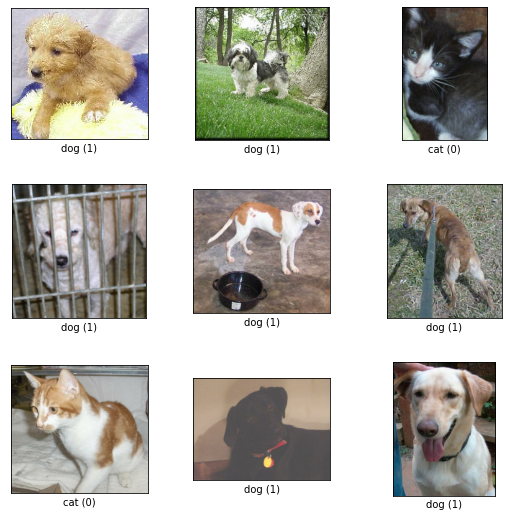

In [7]:
fig = tfds.show_examples(ds_train_raw, ds_info)

In [8]:
print('----- ds_train_raw -----')
for i, example in enumerate(ds_train_raw.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))
print('----- ds_val_raw -----')
for i, example in enumerate(ds_val_raw.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))
print('----- ds_test_raw -----')
for i, example in enumerate(ds_test_raw.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))

----- ds_train_raw -----
Image 1 shape: (350, 350, 3) label: 1
Image 2 shape: (316, 300, 3) label: 0
----- ds_val_raw -----
Image 1 shape: (246, 232, 3) label: 1
Image 2 shape: (180, 200, 3) label: 0
----- ds_test_raw -----
Image 1 shape: (500, 377, 3) label: 0
Image 2 shape: (500, 245, 3) label: 1


In [9]:
for image, label in ds_train_raw.take(1):
  print(image)

tf.Tensor(
[[[ 23  20  11]
  [ 25  22   5]
  [ 99  94  64]
  ...
  [ 57  40  22]
  [ 67  48  31]
  [ 70  51  34]]

 [[ 31  29  17]
  [ 21  18   1]
  [ 82  77  48]
  ...
  [ 65  50  31]
  [ 74  57  39]
  [ 70  53  35]]

 [[ 67  64  47]
  [ 18  13   0]
  [ 53  47  21]
  ...
  [ 55  42  25]
  [ 66  50  34]
  [ 61  45  29]]

 ...

 [[ 85  76  45]
  [ 85  78  49]
  [ 85  80  51]
  ...
  [123 114  99]
  [121 112  97]
  [122 113  98]]

 [[ 82  73  44]
  [ 87  80  51]
  [ 88  83  53]
  ...
  [124 115  98]
  [123 114  97]
  [121 112  95]]

 [[ 80  71  42]
  [ 86  79  50]
  [ 85  79  47]
  ...
  [128 119 102]
  [127 118 101]
  [123 114  97]]], shape=(316, 300, 3), dtype=uint8)


## Preprocess data

In [10]:
def image_preprocess(image, label):
    # convert to tf.float32
    image = tf.cast(image, tf.float32)
    # normalize
    image = (image/255.0)
    # resize image
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    return image, label

ds_train = ds_train_raw.map(image_preprocess)
ds_val = ds_val_raw.map(image_preprocess)
ds_test = ds_test_raw.map(image_preprocess)

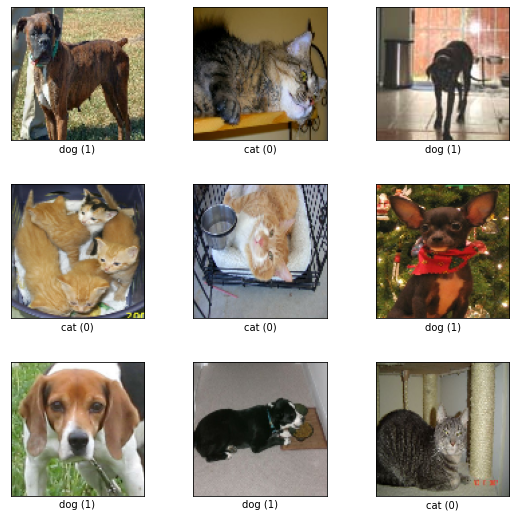

In [11]:
fig = tfds.show_examples(ds_train, ds_info)

In [13]:
print('----- ds_train -----')
for i, example in enumerate(ds_train.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))
print('----- ds_val -----')
for i, example in enumerate(ds_val.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))
print('----- ds_test -----')
for i, example in enumerate(ds_test.take(2)):
    print('Image {} shape: {} label: {}'.format(i+1, example[0].shape, example[1]))

----- ds_train -----
Image 1 shape: (100, 100, 3) label: 1
Image 2 shape: (100, 100, 3) label: 0
----- ds_val -----
Image 1 shape: (100, 100, 3) label: 0
Image 2 shape: (100, 100, 3) label: 1
----- ds_test -----
Image 1 shape: (100, 100, 3) label: 1
Image 2 shape: (100, 100, 3) label: 0
----- ds_train -----
Image 1 shape: (100, 100, 3) label: 1
Image 2 shape: (100, 100, 3) label: 0
----- ds_val -----
Image 1 shape: (100, 100, 3) label: 0
Image 2 shape: (100, 100, 3) label: 1
----- ds_test -----
Image 1 shape: (100, 100, 3) label: 0
Image 2 shape: (100, 100, 3) label: 1


In [14]:
for image, label in ds_train.take(1):
  print(image)

tf.Tensor(
[[[0.03137255 0.03529412 0.00392157]
  [0.01270588 0.01662745 0.        ]
  [0.0054902  0.0054902  0.00235294]
  ...
  [0.         0.         0.        ]
  [0.         0.         0.        ]
  [0.         0.         0.        ]]

 [[0.03137255 0.03529412 0.00392157]
  [0.01270588 0.01662745 0.        ]
  [0.0054902  0.0054902  0.00235294]
  ...
  [0.         0.         0.        ]
  [0.         0.         0.        ]
  [0.         0.         0.        ]]

 [[0.03137255 0.03529412 0.00392157]
  [0.02062353 0.0245451  0.00493725]
  [0.0054902  0.0054902  0.00235294]
  ...
  [0.00313745 0.00313745 0.00313745]
  [0.00784314 0.00784314 0.00784314]
  [0.00784314 0.00784314 0.00784314]]

 ...

 [[0.5962666  0.5803843  0.5333255 ]
  [0.64443135 0.62854904 0.5814902 ]
  [0.64501953 0.6291372  0.5820784 ]
  ...
  [0.8859609  0.27429417 0.18660775]
  [0.9073137  0.2867646  0.17899972]
  [0.92178446 0.28216475 0.16181587]]

 [[0.58449095 0.575313   0.52500004]
  [0.62923294 0.6210416  0

In [15]:
ds_train_batches = ds_train.batch(BATCH_SIZE)
ds_val_batches = ds_val.batch(BATCH_SIZE)
ds_test_batches = ds_test.batch(BATCH_SIZE)

## Data Augmentation layers

In [16]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal"),
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.3),
    tf.keras.layers.experimental.preprocessing.RandomZoom(height_factor=0.2, width_factor=0.2)
])

## Helper functions

In [17]:
# helper functions to plot the validation and training loss and accuracy curves separately
def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  fig, (ax1, ax2) = plt.subplots(1, 2)

  # plot loss
  ax1.plot(epochs, loss, label='tra_loss')
  ax1.plot(epochs, val_loss, label='val_loss')
  ax1.set_title('Loss')
  ax1.set(xlabel='Epochs', ylabel='Loss')
  ax1.legend()

  # plot accuracy
  ax2.plot(epochs, accuracy, label='tra_acc')
  ax2.plot(epochs, val_accuracy, label='val_acc')
  ax2.set_title('Accuracy')
  ax2.set(xlabel='Accuracy', ylabel='Loss')
  ax2.legend()

## Iteration model_00_00 (baseline)
Base model

### Function create model

In [17]:
def make_model():
  model = tf.keras.models.Sequential(
      [tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [18]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_00_00 = make_model()

In [19]:
# compile the model
model_00_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [20]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=10)
]

In [21]:
# fit the model
history_00_00 = model_00_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 31s 49ms/step - loss: 0.6496 - accuracy: 0.6375 - val_loss: 0.6373 - val_accuracy: 0.6527

In [22]:
model_00_00.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 98, 98, 10)        280       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 96, 96, 10)        910       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 94, 94, 10)        910       
_________________________________________________________________
flatten (Flatten)            (None, 88360)             0         
_________________________________________________________________
dense (Dense)                (None, 1)                 88361     
Total params: 90,461
Trainable params: 90,461
Non-trainable params: 0
_________________________________________________________________


In [23]:
model_00_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 24ms/step - loss: 1.8606 - accuracy: 0.6857

[1.8605598211288452, 0.6857265830039978]

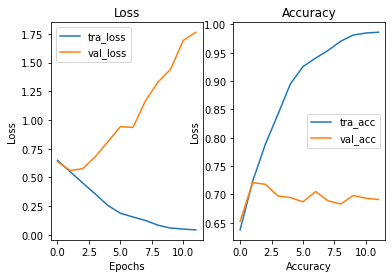

In [24]:
# check out the loss curves of model
plot_loss_curves(history_00_00)

## Iteration model_00_00 (baseline) - Results

Model overfits. From this point we will try to beat this model. We will reduce the patience argument of the EarlyStopping callback to 5 for speeding up the tests performed

## Iteration model_00_01 (baseline)
Base model with Data Augmentation

### Function create model

In [25]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [26]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_00_01 = make_model()

In [27]:
# compile the model
model_00_01.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [28]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [29]:
# fit the model
history_00_01 = model_00_01.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 33s 62ms/step - loss: 0.6823 - accuracy: 0.5629 - val_loss: 0.6730 - val_accuracy: 0.5940

In [30]:
model_00_01.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 98, 98, 10)        280       
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 96, 96, 10)        910       
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 94, 94, 10)        910       
_________________________________________________________________
flatten_1 (Flatten)          (None, 88360)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 88361     
Total params: 90,461
Trainable params: 90,461
Non-trainable params: 0
__________________________________________________

In [31]:
model_00_01.evaluate(ds_test_batches)

73/73 [==============================] - 2s 26ms/step - loss: 0.5351 - accuracy: 0.7365

[0.5351192355155945, 0.7364574670791626]

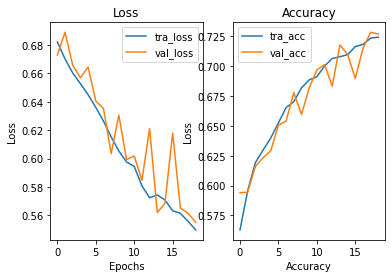

In [32]:
# check out the loss curves of model
plot_loss_curves(history_00_01)

## Iteration model_00_01 (baseline) - Results
Overfitting solved after introducing Data Augmentation. model_00_01 is the new model to beat.

In [33]:
model_best = model_00_01

## Iteration model_01_00
Let's see if the model_00_01 improves by increasing the number of model layers:
* Double the number of Conv2D layers (from 3 to 6, keeping the same number of filters, 10)
* Keep Data Augmentation

### Function create model

In [34]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [35]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_01_00 = make_model()

In [36]:
# compile the model
model_01_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [37]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [38]:
# fit the model
history_01_00 = model_01_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 53s 100ms/step - loss: 0.6903 - accuracy: 0.5290 - val_loss: 0.6897 - val_accuracy: 0.5459

In [39]:
model_01_00.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 98, 98, 10)        280       
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 96, 96, 10)        910       
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 94, 94, 10)        910       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 92, 92, 10)        910       
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 90, 90, 10)        910       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 88, 88, 10)       

In [40]:
model_01_00.evaluate(ds_test_batches)

73/73 [==============================] - 3s 34ms/step - loss: 0.5505 - accuracy: 0.7309

[0.5504876971244812, 0.7308684587478638]

In [41]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 3s 29ms/step - loss: 0.5351 - accuracy: 0.7365 - ETA: 1s - loss: 0.5414 - accuracy: 0.7167

[0.5351191163063049, 0.7364574670791626]

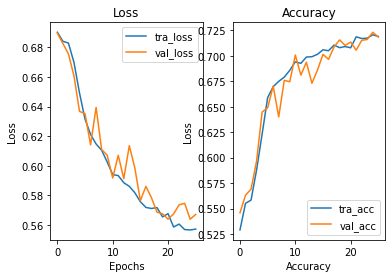

In [42]:
# check out the loss curves of model
plot_loss_curves(history_01_00)

## Iteration model_01_00 - Results
model_01_00 does not improve model_00_01. model_00_01 is still the model to beat.

In [43]:
model_best = model_00_01

## Iteration model_02_00
Let's see if the model_00_01 improves by increasing the number of model layers:
* Double the number of Conv2D layers (from 3 to 4, keeping the same number of filters, 10)
* Keep Data Augmentation

### Function create model

In [44]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [45]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_02_00 = make_model()

In [46]:
# compile the model
model_02_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [47]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [48]:
# fit the model
history_02_00 = model_02_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 38s 72ms/step - loss: 0.6681 - accuracy: 0.5937 - val_loss: 0.6348 - val_accuracy: 0.6224

In [49]:
model_02_00.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 98, 98, 10)        280       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 96, 96, 10)        910       
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 94, 94, 10)        910       
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 92, 92, 10)        910       
_________________________________________________________________
flatten_3 (Flatten)          (None, 84640)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                

In [50]:
model_02_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 25ms/step - loss: 0.5089 - accuracy: 0.7515

[0.5089437365531921, 0.7515047192573547]

In [51]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 23ms/step - loss: 0.5351 - accuracy: 0.7365

[0.5351191759109497, 0.7364574670791626]

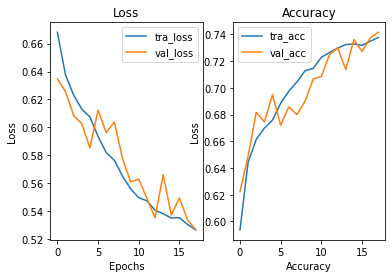

In [52]:
# check out the loss curves of model
plot_loss_curves(history_02_00)

## Iteration model_02_00 - Results
model_02_00 improves loss a little. accuracy value also improves a little. model_02_00 is the new model to beat.

In [54]:
model_best = model_02_00

## Iteration model_03_00
Same as model_02_00 increasing the number of filters in each convolutional layer (from 10 to 32)

### Function create model

In [55]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [56]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_03_00 = make_model()

In [57]:
# compile the model
model_03_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [58]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [59]:
# fit the model
history_03_00 = model_03_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 64s 121ms/step - loss: 0.6884 - accuracy: 0.5569 - val_loss: 0.6878 - val_accuracy: 0.5433

In [60]:
model_03_00.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 98, 98, 32)        896       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 96, 96, 32)        9248      
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 94, 94, 32)        9248      
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 92, 92, 32)        9248      
_________________________________________________________________
flatten_4 (Flatten)          (None, 270848)            0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                

In [61]:
model_03_00.evaluate(ds_test_batches)

73/73 [==============================] - 3s 42ms/step - loss: 0.5664 - accuracy: 0.7369

[0.5663713216781616, 0.7368873357772827]

In [62]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 24ms/step - loss: 0.5089 - accuracy: 0.7515

[0.5089436769485474, 0.7515047192573547]

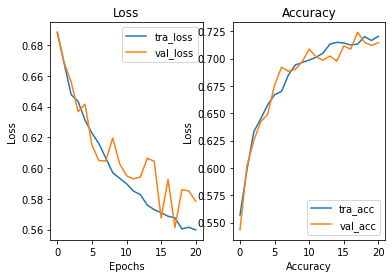

In [63]:
# check out the loss curves of model
plot_loss_curves(history_03_00)

## Iteration model_03_00 - Results
model_03_00 does not improve. model_02_00 is still the model to beat.

In [64]:
model_best = model_02_00

## Iteration model_04_00
Same as model_02_00 but with different values of kernel_size (7, 5, 3 and 3)
Lower values learn smaller features, higher values learn larger features

### Function create model

In [65]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=10, kernel_size=7, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=5, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [66]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_04_00 = make_model()

In [67]:
# compile the model
model_04_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [68]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [69]:
# fit the model
history_04_00 = model_04_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 40s 75ms/step - loss: 0.6811 - accuracy: 0.5683 - val_loss: 0.6719 - val_accuracy: 0.5927

In [70]:
model_04_00.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 94, 94, 10)        1480      
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 90, 90, 10)        2510      
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 88, 88, 10)        910       
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 86, 86, 10)        910       
_________________________________________________________________
flatten_5 (Flatten)          (None, 73960)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 1)                

In [71]:
model_04_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 26ms/step - loss: 0.5848 - accuracy: 0.7051

[0.5847879648208618, 0.7050730586051941]

In [72]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 24ms/step - loss: 0.5089 - accuracy: 0.7515

[0.5089436769485474, 0.7515047192573547]

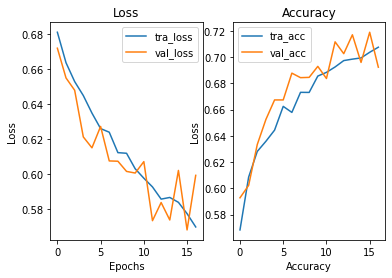

In [73]:
# check out the loss curves of model
plot_loss_curves(history_04_00)

## Iteration model_04_00 - Results
model_04_00 does not improve. model_02_00 is still the model to beat.

In [74]:
model_best = model_02_00

## Iteration model_05_00
Same as model_02_00 with some more filters (32, 64, 128 and 128)

### Function create model

In [75]:

def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.Conv2D(filters=64, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [76]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_05_00 = make_model()

In [77]:
# compile the model
model_05_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [78]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [79]:
# fit the model
history_05_00 = model_05_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 211s 405ms/step - loss: 0.6976 - accuracy: 0.5339 - val_loss: 0.6837 - val_accuracy: 0.5695

In [80]:
model_05_00.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 98, 98, 32)        896       
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 96, 96, 64)        18496     
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 94, 94, 128)       73856     
_________________________________________________________________
conv2d_27 (Conv2D)           (None, 92, 92, 128)       147584    
_________________________________________________________________
flatten_6 (Flatten)          (None, 1083392)           0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                

In [81]:
model_05_00.evaluate(ds_test_batches)

73/73 [==============================] - 9s 125ms/step - loss: 0.6845 - accuracy: 0.5537

[0.6844820976257324, 0.5537403225898743]

In [82]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 25ms/step - loss: 0.5089 - accuracy: 0.7515

[0.5089438557624817, 0.7515047192573547]

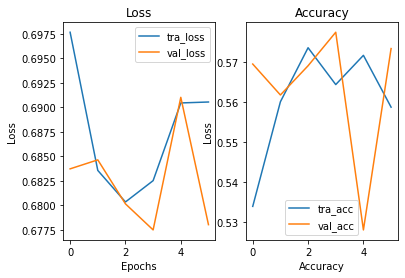

In [83]:
# check out the loss curves of model
plot_loss_curves(history_05_00)

## Iteration model_05_00 - Results
model_05_00 does not improve. model_02_00 is still the model to beat.

In [84]:
model_best = model_02_00

## Iteration model_06_00
Same as model_02_00 adding the layer MaxPool2D

### Function create model

In [85]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=10, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [86]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_06_00 = make_model()

In [87]:
# compile the model
model_06_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [88]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [89]:
# fit the model
history_06_00 = model_06_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 24s 43ms/step - loss: 0.6778 - accuracy: 0.5603 - val_loss: 0.6760 - val_accuracy: 0.5852

In [90]:
model_06_00.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 98, 98, 10)        280       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 49, 49, 10)        0         
_________________________________________________________________
conv2d_29 (Conv2D)           (None, 47, 47, 10)        910       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 23, 23, 10)        0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 21, 21, 10)        910       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 10, 10, 10)       

In [91]:
model_06_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 21ms/step - loss: 0.4851 - accuracy: 0.7696

[0.4850713014602661, 0.7695614695549011]

In [92]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 24ms/step - loss: 0.5089 - accuracy: 0.7515

[0.5089437961578369, 0.7515047192573547]

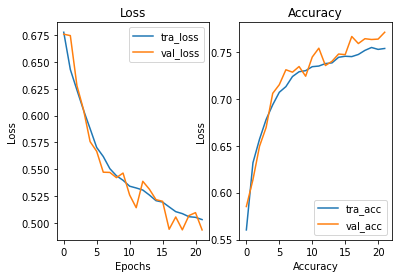

In [93]:
# check out the loss curves of model
plot_loss_curves(history_06_00)

## Iteration model_06_00 - Results
model_06_00 improves loss. accuracy also improves. model_06_00 is the new model to beat.

In [94]:
model_best = model_06_00

## Iteration model_07_00
Same as model_06_00 with some more filters (32, 64, 128 and 128)

### Function create model

In [95]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=64, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [96]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_07_00 = make_model()

In [97]:
# compile the model
model_07_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [98]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [99]:
# fit the model
history_07_00 = model_07_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 33s 62ms/step - loss: 0.6807 - accuracy: 0.5627 - val_loss: 0.6701 - val_accuracy: 0.6202

In [100]:
model_07_00.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_32 (Conv2D)           (None, 98, 98, 32)        896       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_33 (Conv2D)           (None, 47, 47, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 23, 23, 64)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 21, 21, 128)       73856     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 10, 10, 128)      

In [101]:
model_07_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 30ms/step - loss: 0.3472 - accuracy: 0.8538

[0.3471633493900299, 0.8538262844085693]

In [102]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 29ms/step - loss: 0.4851 - accuracy: 0.7696 - ETA: 1s - loss: 0.4898 - accuracy: 0.7608

[0.48507148027420044, 0.7695614695549011]

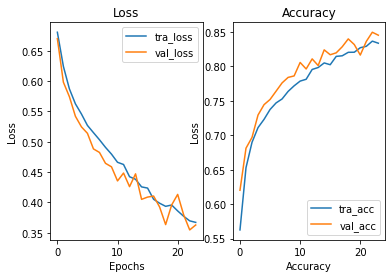

In [103]:
# check out the loss curves of model
plot_loss_curves(history_07_00)

## Iteration model_07_00 - Results
model_07_00 improves loss. accuracy also improves. model_07_00 is the new model to beat.

In [104]:
model_best = model_07_00

## Iteration model_08_00
Same as model_07_00 adding the layer Dropout

### Function create model

In [105]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Dropout(0.2),
       tf.keras.layers.Conv2D(filters=64, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Dropout(0.2),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Dropout(0.2),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Dropout(0.2),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [106]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_08_00 = make_model()

In [107]:
# compile the model
model_08_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [108]:
# create callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5)
]

In [109]:
# fit the model
history_08_00 = model_08_00.fit(
    ds_train_batches,
    epochs=EPOCHS,
    validation_data=ds_val_batches,
    callbacks=callbacks)

Epoch 1/50
509/509 [==============================] - 35s 66ms/step - loss: 0.6810 - accuracy: 0.5535 - val_loss: 0.6391 - val_accuracy: 0.6340

In [110]:
model_08_00.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d_36 (Conv2D)           (None, 98, 98, 32)        896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 49, 49, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_37 (Conv2D)           (None, 47, 47, 64)        18496     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 23, 23, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 23, 23, 64)      

In [111]:
model_08_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 27ms/step - loss: 0.4216 - accuracy: 0.8022

[0.42160311341285706, 0.8022356033325195]

In [112]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 3s 29ms/step - loss: 0.3472 - accuracy: 0.8538

[0.3471633195877075, 0.8538262844085693]

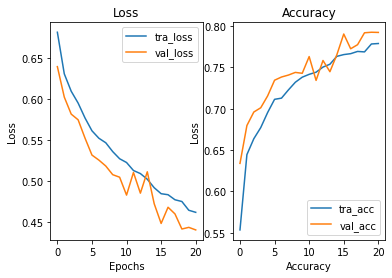

In [113]:
# check out the loss curves of model
plot_loss_curves(history_08_00)

## Iteration model_08_00 - Results
model_08_00 does not improve. model_07_00 is still the model to beat.

In [114]:
model_best = model_07_00

## Iteration model_09_00
Same as model_07_00 with an extra Dense layer after the Flatten one & training without EarlyStopping callback for 100 epochs.

### Function create model

In [17]:
def make_model():
  model = tf.keras.models.Sequential(
      [data_augmentation,
       tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, IMG_DEPTH)),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=64, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu'),
       tf.keras.layers.MaxPool2D((2, 2)),
       tf.keras.layers.Flatten(),
       tf.keras.layers.Dense(128, activation='relu'),
       tf.keras.layers.Dense(1, activation='sigmoid')])
  return model

### Train the model

In [18]:
# set random seed
tf.random.set_seed(RANDOM_STATE)

# create the model
model_09_00 = make_model()

In [19]:
# compile the model
model_09_00.compile(
    loss=tf.keras.losses.BinaryCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(),
    metrics=['accuracy'])

In [20]:
# fit the model
history_09_00 = model_09_00.fit(
    ds_train_batches,
    epochs=100,
    validation_data=ds_val_batches)

Epoch 1/100
509/509 [==============================] - 40s 64ms/step - loss: 0.6793 - accuracy: 0.5604 - val_loss: 0.7088 - val_accuracy: 0.5478

In [21]:
model_09_00.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 100, 100, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 98, 98, 32)        896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 47, 47, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 23, 23, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 21, 21, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 10, 10, 128)      

In [22]:
model_09_00.evaluate(ds_test_batches)

73/73 [==============================] - 2s 25ms/step - loss: 0.2977 - accuracy: 0.8740

[0.29773277044296265, 0.8740326762199402]

In [121]:
model_best.evaluate(ds_test_batches)

73/73 [==============================] - 2s 20ms/step - loss: 0.3472 - accuracy: 0.8538

[0.3471633195877075, 0.8538262844085693]

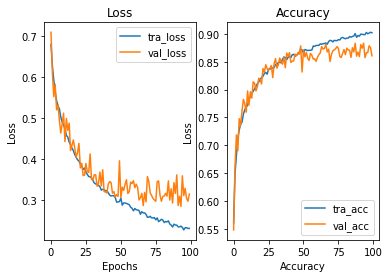

In [23]:
# check out the loss curves of model
plot_loss_curves(history_09_00)

## Iteration model_09_00 - Results
model_09_00 improves loss. accuracy also improves. model_09_00 is the new model to beat.

In [24]:
model_best = model_09_00

In [25]:
model_09_00.save('saved_models/TesnorflowDatasets_ImageClassification_BinaryClassification_CatsVsDogs_model_09_00')

INFO:tensorflow:Assets written to: saved_models/TesnorflowDatasets_ImageClassification_BinaryClassification_CatsVsDogs_model_09_00\assets


INFO:tensorflow:Assets written to: saved_models/TesnorflowDatasets_ImageClassification_BinaryClassification_CatsVsDogs_model_09_00\assets


### Confusion matrix

In [18]:
model_09_00 = tf.keras.models.load_model('saved_models/TesnorflowDatasets_ImageClassification_BinaryClassification_CatsVsDogs_model_09_00')

In [37]:
from sklearn.metrics import confusion_matrix

test_preds =  model_09_00.predict(ds_test_batches)
test_preds[:10]

array([[6.2869512e-02],
       [9.5787746e-01],
       [9.0868950e-01],
       [6.1329575e-03],
       [4.1923013e-05],
       [4.9922124e-01],
       [7.7179348e-01],
       [8.6242563e-01],
       [5.0700712e-01],
       [3.6404875e-01]], dtype=float32)

In [38]:
test_preds = np.round(test_preds)
test_preds[:10]

array([[0.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [0.]], dtype=float32)

In [39]:
test_labels = []
for image, label in tfds.as_numpy(ds_test_raw):
  test_labels.append(label)
test_labels[:10]

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0]

In [40]:
confusion_matrix(test_labels, test_preds)

array([[728, 432],
       [395, 771]], dtype=int64)